In [1]:
from anndata import read_h5ad
import pandas as pd
import numpy as np
import scvi
import scanpy as sc

%load_ext nb_black
use_cuda = True


In [2]:
import matplotlib.pyplot as plt

%matplotlib inline

In [3]:
data_path = "../TabulaSapiensData/"

In [4]:
adata = read_h5ad(data_path + "decontX/Pilot1_Pilot2.decontX.h5ad")

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9002. The TBB threading layer is disabled.
  warnings.warn(problem)
/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


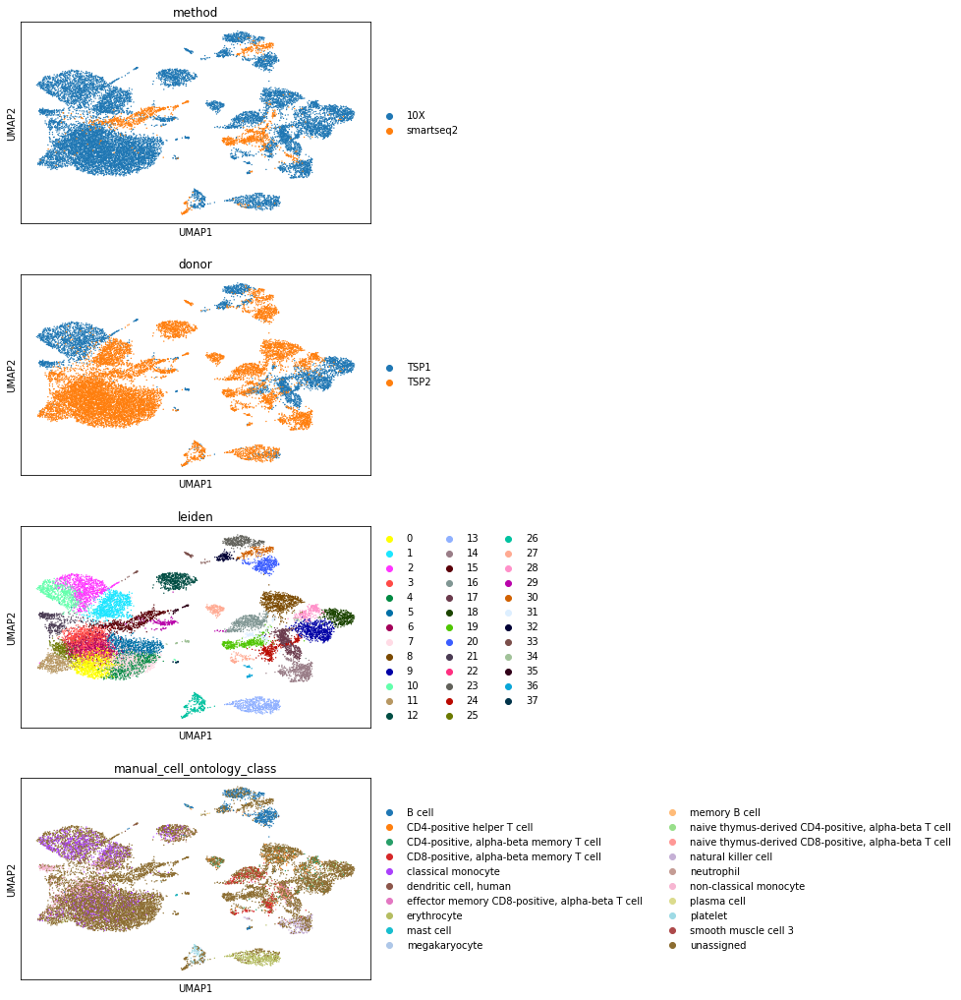

In [5]:
organ = "Blood"
organ_adata = adata[adata.obs["tissue"] == organ]
sc.pp.neighbors(organ_adata, use_rep="X_scvi_decontX")
sc.tl.umap(organ_adata)
organ_adata.obsm["X_umap_decontX"] = organ_adata.obsm["X_umap"].copy()
sc.tl.leiden(organ_adata, resolution=2)
sc.pl.umap(
    organ_adata,
    color=["method", "donor", "leiden", "manual_cell_ontology_class"],
    ncols=1,
)
organ_adata.X = np.log1p(organ_adata.X)

# cluster to celltype correspondance
count is a matrix of cluster-cell type correspondance, where each row is a celltype, and each colum is a cluster. The entries to the matrix is the number of cells that is annotated as celltype *X* and cluster *Y*

In [6]:
count = {}
for c in np.unique(organ_adata.obs["leiden"]):
    count[c] = {}
    for t in np.unique(organ_adata.obs["manual_cell_ontology_class"]):
        count[c][t] = np.sum(
            (organ_adata.obs["leiden"].astype(str) == c)
            & (organ_adata.obs["manual_cell_ontology_class"] == t)
        )

count = pd.DataFrame.from_dict(count)

We can visualize the cluster assignment of each cell type through this heatmap. The color is normalized for each celltype 

<AxesSubplot:>

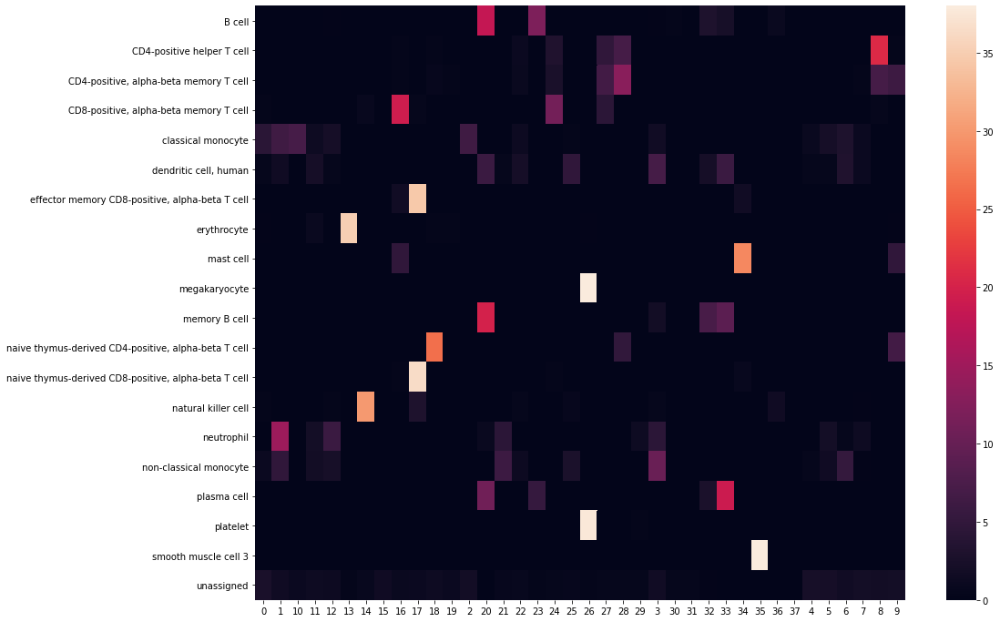

In [7]:
import seaborn

plt.figure(figsize=(16, 12))
seaborn.heatmap((count.T / count.mean(axis=1)).T)

# dictionary of cell type composition of each cluster 
What are clusters previously annotated as 

In [8]:
cluster_composition = {}
for x in count.columns.values:
    t = count.index[count[x] > 0].values
    freq = np.asarray([count.loc[y, x] for y in t]) / count[x].sum()
    res = [a + ": %.2f" % b for a, b in zip(t, freq)]
    cluster_composition[x] = res

In [9]:
cluster_composition["0"]

['B cell: 0.00',
 'CD8-positive, alpha-beta memory T cell: 0.00',
 'classical monocyte: 0.17',
 'dendritic cell, human: 0.00',
 'erythrocyte: 0.00',
 'natural killer cell: 0.00',
 'non-classical monocyte: 0.02',
 'unassigned: 0.80']

# Reassign pure clusters
If a cluster is very pure (>95% of annotated cells come from the same celltype, we reassign the clusters to all have the same labels) 

In [10]:
def Purity(x):
    names = x.index
    x = np.asarray(x).ravel()
    x = x[names != "unassigned"]
    return (np.max(x) / np.sum(x), names[np.argmax(x)])

In [11]:
cluster_purity = count.apply(Purity, axis=0).T
confident_clusters = cluster_purity[cluster_purity[0] > 0.95].index

<ipython-input-1-963029a66ab7>:5: RuntimeWarning: invalid value encountered in long_scalars
  return (np.max(x) / np.sum(x), names[np.argmax(x)])


In [12]:
for i in confident_clusters:
    organ_adata.obs.loc[
        organ_adata.obs["leiden"] == i, "new_manual_cell_ontology_class"
    ] = cluster_purity.loc[i, 1]

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'new_manual_cell_ontology_class' as categorical


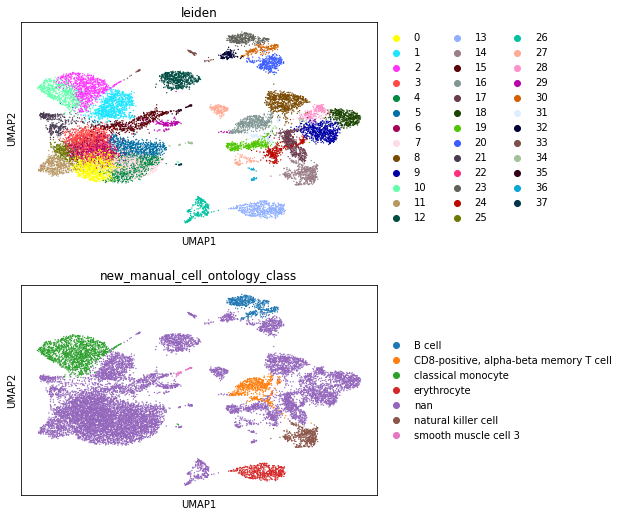

In [13]:
sc.pl.umap(
    organ_adata,
    color=["leiden", "new_manual_cell_ontology_class"],
    ncols=1,
)

# Sankey Diagram between cluster and cell types

In [14]:
from utils.colorDict import donor_colors, method_colors, compartment_colors, tissue_colors

In [15]:
from utils.plotting_utils import *
from utils.colorDict import compartment_colors

import plotly
import chart_studio.plotly as py
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

import plotly.io as pio

pio.renderers.default = "notebook"

init_notebook_mode(connected=True)

In [16]:
df = pd.DataFrame(columns=["celltype", "compartment", "count"])
for t in np.unique(organ_adata.obs["manual_cell_ontology_class"]):
    for c in np.unique(organ_adata.obs["compartment_pred_svm"]):
        x = np.sum(
            (organ_adata.obs["compartment_pred_svm"].astype(str) == c)
            & (organ_adata.obs["manual_cell_ontology_class"] == t)
        )
        df = df.append(
            pd.DataFrame([t, c, x], index=["celltype", "compartment", "count"]).T,
            ignore_index=True,
        )


fig = genSankey(
    df,
    cat_cols_color=[compartment_colors(), "#00A1E0"],
    cat_cols=["compartment", "celltype"],
    value_cols="count",
    title="celltype-compartment",
)
iplot(fig, validate=False)
plotly.offline.plot(
    fig, validate=False, filename="figures/celltype_sankey_%s" % organ + ".html"
)  # , output_type='div')

'figures/celltype_sankey_Blood.html'

# visualize compartment markers

In [17]:
compartment_markers = {
    "Epithelial": ["CDH1", "CLDN4", "EPCAM"],
    "Endothelial": ["CA4", "CDH5", "CLDN5", "PECAM1", "VWF"],
    "Stromal": ["BGN", "DCN", "COL1A2"],
    "Immune": ["LCP1", "PTPRC", "RAC2"],
}

In [18]:
for x in compartment_markers.keys():
    sc.tl.score_genes(organ_adata, compartment_markers[x], score_name="%s_score" % x)

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



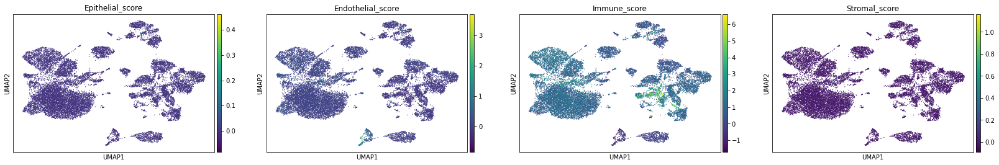

In [19]:
sc.pl.umap(
    organ_adata,
    color=["Epithelial_score", "Endothelial_score", "Immune_score", "Stromal_score"],
)

# Find markers for each cluster

In [20]:
sc.tl.rank_genes_groups(organ_adata, groupby="leiden", method="wilcoxon")

In [21]:
def FormatDE(res):
    groups = res['scores'].dtype.names
    df_res = {}
    for group in groups:
        df = pd.DataFrame([res['scores'][group],
                           res['logfoldchanges'][group],res['pvals_adj'][group]], 
                           columns=res['names'][group],
                           index=['wilcoxon_score','log fold change','adjusted pvalue'])
        df_res[group] = df
    return df_res


In [22]:
DE = FormatDE(organ_adata.uns["rank_genes_groups"])

### top positive marker genes

In [23]:
for x in DE.keys():
    print(x)
    display(DE[x].T[:20])

0


,wilcoxon_score,log fold change,adjusted pvalue
S100A9,38.174721,4.371098,0.000000e+00
LGALS1,38.112762,2.673520,0.000000e+00
LYZ,36.793514,3.587410,4.600361e-292
CAPG,36.637524,2.249778,1.064190e-289
S100A10,36.517776,2.094100,6.819694e-288
RNASE2,36.006104,2.407090,6.587621e-280
S100A12,35.562603,2.955380,4.462496e-273
GAPDH,35.301929,1.926568,4.036563e-269
SERPINB1,34.821110,1.994112,7.624833e-262
S100A8,34.754295,3.976522,7.027402e-261


1


,wilcoxon_score,log fold change,adjusted pvalue
MTCO1P12,34.589912,2.438834,2.109045e-257
CD163,29.532663,2.306767,3.227936e-187
METTL7A,25.774570,1.667168,2.516751e-142
KCTD12,25.700665,1.777895,1.352899e-141
CTSB,25.344282,1.752668,1.019482e-137
ADA2,25.300409,1.523314,2.326342e-137
FKBP5,24.201456,1.380306,1.264288e-125
IRAK3,23.834675,1.536654,7.163447e-122
MARCH1,23.636751,1.461021,7.315328e-120
STAB1,23.610640,1.577492,1.260143e-119


2


,wilcoxon_score,log fold change,adjusted pvalue
CD36,43.653831,4.049295,0.0
FCN1,43.564457,4.219832,0.0
LTA4H,43.533848,4.124313,0.0
CLEC12A,42.804024,3.743813,0.0
JAML,42.480236,3.552455,0.0
GRN,42.471527,3.269469,0.0
MT-ND3,42.399109,2.640957,0.0
SERPINA1,42.327507,3.629068,0.0
ITGB2,42.268795,3.205265,0.0
MNDA,42.159927,3.540632,0.0


3


,wilcoxon_score,log fold change,adjusted pvalue
CD163,35.606907,2.896738,6.447889e-273
RNASE1,33.593166,3.452029,6.213395e-243
VSIG4,32.803928,3.080931,1.015633e-231
CST3,31.687899,2.542564,3.356748e-216
CTSB,31.068998,2.185694,7.440965e-208
MTND1P23,30.792891,2.085534,3.201151e-204
NPC2,30.143114,1.977380,1.110426e-195
HMOX1,30.091372,2.213137,4.624195e-195
KLF9,29.963284,2.135859,1.932292e-193
FCGR3A,29.365427,2.578699,8.939043e-186


4


,wilcoxon_score,log fold change,adjusted pvalue
FOLR3,26.895605,2.148456,3.638500e-155
S100A8,26.138855,3.614126,1.553542e-146
RBP7,25.176401,1.877794,6.109686e-136
S100A12,24.700405,2.246692,6.925986e-131
PLBD1,20.406958,1.459902,3.557661e-89
IL1R2,20.273067,1.782338,5.236026e-88
AC020656.1,20.231144,1.836004,1.179243e-87
S100A9,19.391405,3.149523,1.677998e-80
GCA,18.528852,1.250682,1.778432e-73
SAP30,18.210012,1.292792,5.751200e-71


5


,wilcoxon_score,log fold change,adjusted pvalue
FOLR3,24.612173,1.963736,5.508828e-129
IFITM2,22.177969,1.182149,5.499703e-105
RBP7,21.360619,1.545931,2.032155e-97
IRS2,21.133383,1.437599,2.310047e-95
CLEC4E,20.654713,1.514291,4.343976e-91
CD163,20.617695,1.679014,8.622838e-91
AC020656.1,19.984100,1.826629,2.477091e-85
NAMPT,19.310659,1.414420,1.028967e-79
SAP30,18.790432,1.382046,1.835904e-75
C5AR1,18.253397,1.288003,3.468538e-71


6


,wilcoxon_score,log fold change,adjusted pvalue
CST3,32.206936,2.616794,8.308667e-223
CD163,31.640331,2.637307,3.032114e-215
VSIG4,30.947943,2.983166,5.313837e-206
AIF1,30.454779,2.569282,1.524008e-199
NPC2,30.148817,2.019985,1.308793e-195
MS4A6A,30.062248,2.356205,1.481871e-194
C1orf162,29.522678,1.875244,1.238937e-187
LGALS3,29.176178,2.077520,2.862528e-183
HMOX1,29.010887,2.208603,3.137169e-181
FTL,28.925770,2.105715,3.333475e-180


7


,wilcoxon_score,log fold change,adjusted pvalue
S100A12,26.083977,2.515352,3.262237e-145
S100A8,25.208941,3.551296,4.704218e-136
IL1R2,23.675783,2.263153,7.542107e-120
S100A9,20.822380,3.300869,1.452277e-92
PLBD1,20.538326,1.564999,4.432351e-90
SERPINB1,19.446350,1.296100,1.151363e-80
AC020656.1,18.890951,1.814336,3.795288e-76
RETN,17.582304,1.928405,7.621691e-66
GCA,17.562481,1.224617,1.040952e-65
FOLR3,16.985861,1.315181,2.050800e-61


8


,wilcoxon_score,log fold change,adjusted pvalue
GAS5,35.126972,2.496168,1.538090e-265
CD69,34.910427,3.361297,1.520295e-262
RPS12,34.082253,1.855075,2.652215e-250
RPS26,33.968979,1.568862,9.417574e-249
RPL10P9,33.702976,2.540347,6.156188e-245
IL7R,33.659821,3.560162,2.197680e-244
LEPROTL1,33.475304,2.492674,9.274269e-242
RPS27A,33.249477,1.701356,1.528454e-238
RPL14,32.967407,1.731997,1.558178e-234
RPL30,32.584133,1.542914,4.051197e-229


9


,wilcoxon_score,log fold change,adjusted pvalue
LTB,38.743984,4.958250,0.000000e+00
RPS29,37.392826,2.515891,1.504320e-301
TRAC,36.848381,3.809431,6.091811e-293
IL32,35.868313,4.097034,1.402888e-277
IL7R,35.419998,4.186534,9.897015e-271
RPS27,34.596024,2.305410,2.844944e-258
CD3D,34.531269,3.213210,2.290548e-257
LDHB,34.270744,2.551503,1.575845e-253
CD3E,34.251526,3.292702,2.707534e-253
GIMAP7,33.506729,2.648850,2.264206e-242


10


,wilcoxon_score,log fold change,adjusted pvalue
VNN2,36.845215,4.321264,2.053806e-292
CD14,36.364365,3.955663,4.586299e-285
FPR1,36.127529,3.251719,1.645513e-281
JAML,36.089520,3.409735,4.874113e-281
CSF3R,35.923550,3.221730,1.542777e-278
SERPINA1,35.884945,3.395515,5.147553e-278
CLEC12A,35.788380,3.484266,1.408406e-276
RGS2,35.394135,3.667299,1.546769e-270
LTA4H,35.251358,3.521734,2.139122e-268
FCN1,35.083668,3.684868,7.041800e-266


11


,wilcoxon_score,log fold change,adjusted pvalue
PPBP,35.188797,4.680793,1.746586e-266
NRGN,33.531128,3.134915,4.993262e-242
PF4,32.368046,3.958390,1.517393e-225
ITGA2B,32.191380,3.978971,3.429180e-223
TUBB1,31.566607,4.156858,1.249367e-214
TREML1,30.258499,3.788370,3.957264e-197
CAVIN2,29.583298,3.784554,2.061221e-188
GNG11,27.971178,3.533071,2.681246e-168
HIST1H2AC,26.895720,3.057443,1.612153e-155
CLU,26.718063,2.332912,1.709266e-153


12


,wilcoxon_score,log fold change,adjusted pvalue
GABARAP,33.858273,3.345561,1.614203e-246
NME2,30.283470,3.917005,1.392550e-197
ATP6V0C,27.713821,4.808448,1.647827e-165
ALDOA,27.120193,2.408325,1.763373e-158
IFITM3,22.074064,2.024708,8.258483e-105
IFI30,20.507132,2.067430,1.990270e-90
GNG5,18.112638,1.365387,1.553372e-70
AL138963.3,17.644251,4.994941,5.817620e-67
STAB1,16.474680,1.311307,2.379687e-58
CFP,15.776540,2.926232,1.639850e-53


13


,wilcoxon_score,log fold change,adjusted pvalue
HBA1,38.922958,16.131983,0.000000e+00
HBA2,38.849625,16.770222,0.000000e+00
HBB,38.846909,19.192738,0.000000e+00
ALAS2,38.252502,12.407479,0.000000e+00
SLC25A37,37.926739,5.695243,0.000000e+00
SLC25A39,37.734333,5.632521,0.000000e+00
SNCA,37.158760,6.699988,4.778183e-299
GYPC,36.185604,4.225434,6.422614e-284
YBX3,34.900242,3.366879,3.472055e-264
HBD,34.777504,10.581475,2.448104e-262


14


,wilcoxon_score,log fold change,adjusted pvalue
GNLY,35.856171,7.199993,8.676700e-277
KLRD1,35.296379,5.707181,1.964415e-268
NKG7,34.904503,4.770989,1.246621e-262
PRF1,34.110458,5.278142,7.596552e-251
GZMA,33.743263,5.253514,1.580366e-245
GZMB,32.879040,5.528638,4.299276e-233
HOPX,32.679504,4.413301,2.568247e-230
CTSW,31.924709,4.180165,8.923378e-220
KLRF1,31.858152,6.669435,6.639279e-219
CST7,31.502539,4.086127,4.720204e-214


15


,wilcoxon_score,log fold change,adjusted pvalue
AL512646.1,34.755413,8.222655,6.759385e-260
MT-RNR2,31.931767,3.996178,2.848629e-219
MTRNR2L12,30.905891,6.414686,1.953380e-205
RPL13P12,29.774096,4.944242,1.244825e-190
MT-ATP8,29.579233,4.848178,3.254843e-188
SLC11A1,28.650530,5.138865,1.327840e-176
FTH1P20,28.490889,6.307536,1.117947e-174
FTLP3,28.116812,5.826373,3.992335e-170
RPS28P7,28.076632,6.025270,1.112652e-169
AC114801.3,27.774284,8.631577,4.352281e-166


16


,wilcoxon_score,log fold change,adjusted pvalue
CCL5,32.468739,4.302593,1.734611e-226
GZMA,31.817030,4.294266,1.107872e-217
LYAR,31.705648,3.298400,2.548490e-216
CST7,27.757589,2.997829,2.076867e-165
FGFBP2,26.892061,3.966076,1.779041e-155
IL7R,26.758896,3.286514,5.206822e-154
CD3D,25.500404,2.349550,7.178584e-140
GNLY,24.869253,4.158710,4.960816e-133
ISG20,24.405315,1.999866,3.844002e-128
ARL4C,24.188160,2.222125,6.462771e-126


17


,wilcoxon_score,log fold change,adjusted pvalue
NKG7,33.597725,4.581614,1.066121e-242
GZMA,32.648251,4.761368,2.497605e-229
CST7,32.279686,4.005992,2.646727e-224
CCL5,32.270489,4.614061,2.671693e-224
PRF1,31.483004,4.671037,1.747611e-213
CTSW,31.223553,3.681338,5.008149e-210
GZMM,31.072304,3.826013,4.795747e-208
KLRD1,29.758993,4.832752,9.762229e-191
CD2,29.161833,3.094117,3.481715e-183
CCL4,29.114428,4.583736,1.261810e-182


18


,wilcoxon_score,log fold change,adjusted pvalue
CCR7,32.778793,4.394618,6.952870e-231
RPS29,31.636925,2.442391,3.377342e-215
TCF7,31.572327,3.693794,1.737957e-214
RPL9P9,30.084103,2.438165,1.151175e-194
RPS27,29.966459,2.351300,3.162233e-193
BCL11B,29.821768,3.622502,2.001676e-191
LTB,29.441444,3.847181,1.362498e-186
RPS21,29.228054,1.907707,6.281833e-184
PRKCQ-AS1,28.756889,3.153550,4.858702e-178
TRAC,28.423571,3.064558,6.088448e-174


19


,wilcoxon_score,log fold change,adjusted pvalue
EEF1A1P5,31.684607,9.162252,1.490557e-215
EEF1A1P6,31.403185,7.759145,5.388520e-212
RPL7P9,31.379330,7.526543,6.392949e-212
RPS3AP6,31.375685,7.156106,6.392949e-212
RPL13AP5,31.292227,8.495278,7.008793e-211
RPL18AP3,31.234282,7.257521,3.581151e-210
EEF1A1,31.220285,6.021177,4.754287e-210
RPL3,31.180357,7.434235,1.447718e-209
RPL13A,31.168892,6.933674,1.840418e-209
RPS3,31.129379,6.422102,5.678548e-209


20


,wilcoxon_score,log fold change,adjusted pvalue
CD79A,29.966413,5.555500,1.583264e-192
MS4A1,27.966560,4.742386,9.668919e-168
TNFRSF13C,27.960400,5.334873,9.668919e-168
IGHM,27.947205,5.738078,1.049185e-167
IGHD,27.826429,5.563348,2.446456e-166
JUND,27.205441,2.601296,5.494815e-159
CXCR4,26.691048,2.846423,5.028709e-153
BTG1,26.391665,2.389720,1.005450e-149
HLA-DQA1,26.182980,5.348752,2.222460e-147
AL139020.1,24.365488,4.421016,1.461812e-127


21


,wilcoxon_score,log fold change,adjusted pvalue
FCGR3A,30.529488,5.470373,6.232119e-200
LST1,29.339668,3.959844,9.528047e-185
MS4A7,28.381069,4.345217,6.796419e-173
SMIM25,27.975786,4.557135,4.713125e-168
TCF7L2,27.449663,5.574207,8.256102e-162
IFITM3,26.712606,3.569801,3.296445e-153
AIF1,26.351124,3.290064,4.190206e-149
IFITM2,25.592514,2.516655,1.360081e-140
HLA-DPA1,25.555391,3.406926,3.128674e-140
FCER1G,25.195484,3.193697,2.642766e-136


22


,wilcoxon_score,log fold change,adjusted pvalue
MTND1P23,18.659937,1.937451,6.172900e-73
KLF10,18.168671,1.966985,2.689949e-69
AHNAK,17.468882,1.648816,4.852809e-64
LMNA,16.859461,2.108320,1.315760e-59
VCAN,16.700876,2.389599,1.520646e-58
CD163,16.618893,2.039722,4.990524e-58
RBM3,16.271662,1.285919,1.319056e-55
RNASE1,15.819201,2.189277,1.687994e-52
CTSB,15.568445,1.689260,7.155028e-51
CAST,15.567240,1.334060,7.155028e-51


23


,wilcoxon_score,log fold change,adjusted pvalue
IGHM,30.395746,7.361365,3.680565e-198
CD79A,29.825191,5.775341,5.421544e-191
IGHD,29.334951,5.876313,7.295891e-185
AL139020.1,29.198875,6.118790,2.949389e-183
MS4A1,29.098082,5.199493,4.469608e-182
CD79B,28.766567,4.503471,5.515500e-178
LINC00926,28.084211,5.263874,1.284441e-169
HLA-DPB1,26.383858,3.196308,1.373123e-149
CD37,25.932940,2.234002,1.515882e-144
BANK1,25.788269,4.388522,5.436853e-143


24


,wilcoxon_score,log fold change,adjusted pvalue
IL32,26.837769,5.576529,6.898529e-154
CD3D,26.654303,4.768496,4.696352e-152
TRAC,25.940563,4.710117,4.559613e-144
CD2,25.645966,4.359735,6.902164e-141
CD3G,25.186201,4.241055,6.680452e-136
LCK,25.122349,4.223702,2.781494e-135
CD27,24.747473,4.856577,2.775891e-131
CD52,23.670368,3.651517,5.359672e-120
TRBC2,23.507172,4.083095,2.253463e-118
ISG20,23.481611,3.538170,3.701265e-118


25


,wilcoxon_score,log fold change,adjusted pvalue
RNASE1,19.098597,3.313305,1.526867e-76
VSIG4,18.276644,2.763408,3.738400e-70
CST3,18.017467,2.354474,2.788508e-68
HMOX1,16.624504,2.078923,6.816931e-58
MTND1P23,16.134501,1.837508,1.718822e-54
NPC2,16.102997,1.758540,2.384616e-54
HLA-DRA,15.922467,2.188831,3.722046e-53
CD163,15.898594,2.137163,4.768719e-53
RPL10P9,15.887642,1.817790,5.048233e-53
MT2A,15.773623,1.972766,2.782192e-52


26


,wilcoxon_score,log fold change,adjusted pvalue
TUBB1,26.937721,8.399273,4.677160e-155
PPBP,26.846537,9.322019,2.339095e-154
PF4,26.837133,8.771461,2.339095e-154
ITGA2B,26.690496,8.023043,8.930917e-153
CAVIN2,26.519146,7.910505,6.864473e-151
GP9,26.194639,8.675986,3.001065e-147
GNG11,26.084007,7.540611,4.656604e-146
TREML1,25.955832,7.951672,7.665823e-145
MPIG6B,25.897442,7.639141,2.793013e-144
SPARC,25.675812,7.197612,5.827709e-142


27


,wilcoxon_score,log fold change,adjusted pvalue
IFITM1,22.799221,3.441290,6.869457e-111
RPS26,20.931446,1.645498,1.630498e-93
PTPRCAP,20.850672,8.102757,8.043811e-93
CD3E,20.053282,3.035671,6.952445e-86
IL32,18.903170,3.003119,2.749037e-76
IL7R,17.368544,2.893084,2.272119e-64
NME2,15.668937,3.004918,2.268988e-52
LCK,14.320136,1.758236,7.776639e-44
CD3D,14.244772,1.653968,2.187801e-43
C12orf57,14.195257,1.710826,4.338926e-43


28


,wilcoxon_score,log fold change,adjusted pvalue
BCL11B,21.489050,3.635849,5.801793e-98
IL7R,20.659826,3.893387,1.563008e-90
PRKCQ-AS1,20.403715,3.262097,2.280905e-88
ETS1,20.278273,3.023489,2.355228e-87
BCL2,19.492157,3.455617,1.076224e-80
CD69,19.042940,2.846520,5.532804e-77
PIK3IP1,18.578707,2.231673,2.813284e-73
TCF7,18.552225,2.995045,4.187556e-73
TXK,18.145716,3.083306,6.286132e-70
LDHB,18.069109,1.979419,2.190301e-69


29


,wilcoxon_score,log fold change,adjusted pvalue
MT-CO3,14.718737,1.294847,1.102300e-46
MTATP6P1,14.208294,1.440866,1.646413e-43
MT-RNR1,14.117782,1.514182,5.869861e-43
MTND1P23,13.896033,1.944724,1.255208e-41
MT-CO2,13.868578,1.274264,1.829515e-41
MT-RNR2,13.751040,1.554458,9.065672e-41
MT-ATP6,13.722724,1.361257,1.324095e-40
MT-CYB,13.459679,1.139122,4.491556e-39
MT-CO1,12.344438,1.144632,7.281713e-33
MT-ND5,12.324430,1.119919,9.290734e-33


30


,wilcoxon_score,log fold change,adjusted pvalue
CD74,22.156893,10.006302,5.269976e-104
MS4A1,21.444565,11.580461,1.510745e-97
MT-CYB,20.468950,5.299646,7.992646e-89
MT-CO3,20.424397,4.719460,1.493898e-88
RPL18AP3,20.396082,6.082541,2.133015e-88
HLA-DRA,20.254677,6.806930,2.816876e-87
EEF1A1P5,20.252897,6.818043,2.816876e-87
CD52,20.161207,6.993740,1.579057e-86
RPL21,19.975386,4.589882,5.899006e-85
MALAT1,19.914867,5.059048,1.780504e-84


31


,wilcoxon_score,log fold change,adjusted pvalue
B2M,19.060923,6.467039,3.139325e-76
TMSB4XP8,18.919224,8.859120,2.080794e-75
TMSB4X,18.892742,5.736762,2.080794e-75
MT-CO3,18.887087,5.039720,2.080794e-75
MALAT1,18.872961,5.960549,2.080794e-75
MT-CO1,18.867245,5.620043,2.080794e-75
MT-CO2,18.794970,5.018909,6.982584e-75
EEF1A1P5,18.345949,6.914215,2.617258e-71
RPL21,18.192930,4.694809,3.840626e-70
RPL23A,18.077768,5.224015,2.808137e-69


32


,wilcoxon_score,log fold change,adjusted pvalue
MS4A1,18.554893,5.900349,4.383107e-72
CD79A,18.420395,5.830024,2.351746e-71
BANK1,18.404972,5.739278,2.351746e-71
RALGPS2,17.829767,5.028919,6.109866e-67
HLA-DPB1,17.652807,3.996008,1.113742e-65
CD79B,17.643824,4.518843,1.113742e-65
HLA-DPA1,17.051842,3.602367,2.848395e-61
TNFRSF13C,16.839792,4.822086,9.174281e-60
HLA-DRA,16.540306,3.635095,1.230151e-57
CD37,16.241848,2.386534,1.501920e-55


33


,wilcoxon_score,log fold change,adjusted pvalue
CD74,12.328952,3.301538,3.724365e-30
HLA-DPB1,11.811461,3.148601,1.002528e-27
HLA-DPA1,11.016957,2.939581,6.212351e-24
HLA-DRB1,10.686694,3.025122,1.729068e-22
HLA-DQB1,10.305624,3.627894,7.824898e-21
HLA-DQA2,10.247256,5.242258,1.194577e-20
CD79A,10.025334,4.381651,7.715892e-20
BLK,9.914600,4.433483,1.925016e-19
HLA-DRA,9.618405,2.721951,3.027709e-18
HLA-DQA1,9.330936,4.090833,4.041319e-17


34


,wilcoxon_score,log fold change,adjusted pvalue
FCGR3B,8.306996,5.660734,1.605112e-13
CST7,6.969250,2.365844,1.150798e-09
SYNE2,5.189222,1.913263,2.235940e-05
ETS1,5.131805,1.350698,2.969128e-05
ARL4C,5.020709,1.481520,4.935986e-05
CD2,4.976986,1.465129,6.015721e-05
LINC00861,4.784720,1.726696,1.450366e-04
IL32,4.654234,1.253744,2.559327e-04
TRBC1,4.477214,1.550529,5.409422e-04
CXCR2,4.243283,3.401426,1.414119e-03


35


,wilcoxon_score,log fold change,adjusted pvalue
AL512646.1,5.840594,3.669702,4.154860e-07
CSF3R,4.063985,2.548653,1.765070e-03
SLC25A37,3.125228,2.748927,4.262137e-02
ALPL,3.019582,5.708390,5.820857e-02
MMP25,2.385995,4.114129,2.874605e-01
BASP1,2.143219,2.722168,4.844771e-01
CXCR2,1.948306,4.301575,7.068573e-01
FTH1P20,1.943091,1.431449,7.131484e-01
AL627309.6,1.885641,3.589968,7.916485e-01
IL1R2,1.879264,2.235767,8.006478e-01


36


,wilcoxon_score,log fold change,adjusted pvalue
CTSW,8.366363,3.261577,3.498306e-12
HOPX,7.033704,3.869184,1.809354e-08
MIF,7.024299,2.327393,1.809354e-08
RASSF1,7.002031,3.013078,1.856456e-08
HSH2D,6.953754,3.941499,2.093948e-08
STMN1,6.924832,4.761209,2.141367e-08
IFITM1,6.828247,3.336362,3.892609e-08
NUCB2,6.763582,3.562854,4.953219e-08
MLLT3,6.672630,4.644409,8.240685e-08
AKR1C3,6.481815,6.021633,2.807971e-07


37


,wilcoxon_score,log fold change,adjusted pvalue
IFITM2,5.842296,3.957883,0.000023
ALPL,5.738194,8.599055,0.000023
NAMPT,5.625061,3.886025,0.000024
AQP9,5.547642,3.681216,0.000027
BASP1,5.545654,5.169238,0.000027
SLC25A37,5.538757,4.570535,0.000028
CSF3R,5.328770,3.832258,0.000071
GCA,5.280255,3.697861,0.000086
CXCR2,5.164374,6.613897,0.000151
ACSL1,5.012810,3.235399,0.000313


### for cluster 0 plot the top marker genes

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



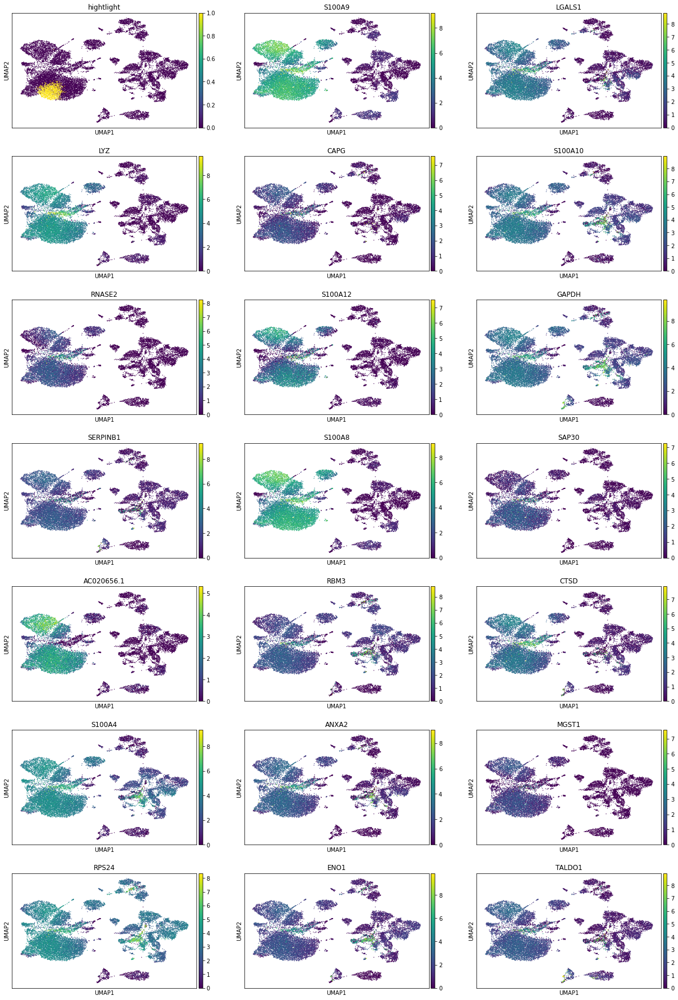

In [24]:
topgenes = list(DE["0"].T[:20].index)
organ_adata.obs["hightlight"] = organ_adata.obs["leiden"] == "0"
sc.pl.umap(
    organ_adata,
    color=["hightlight"] + topgenes,
    ncols=3,
)

You can do this for other clusters as well. Here I plot the top 5 genes for all other clusters

0


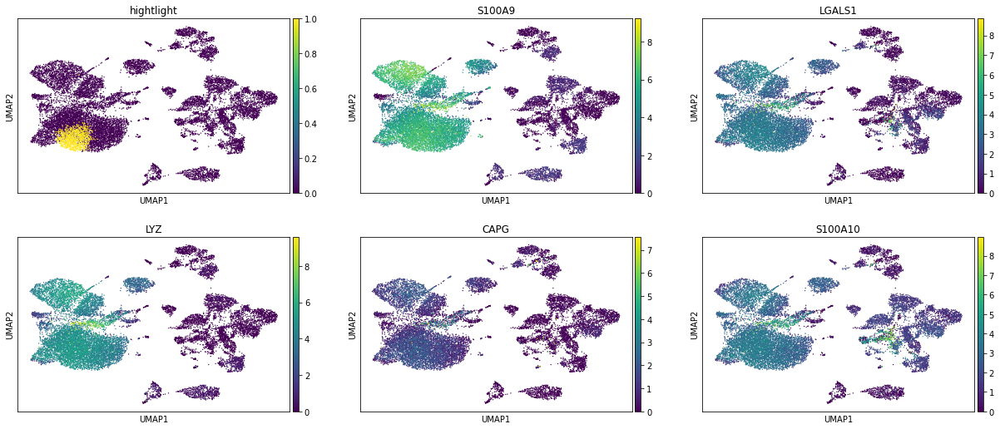

1


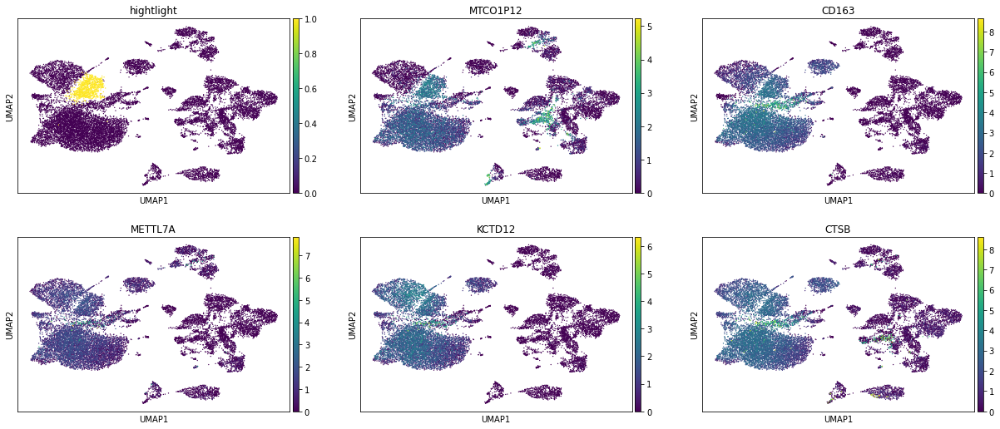

2


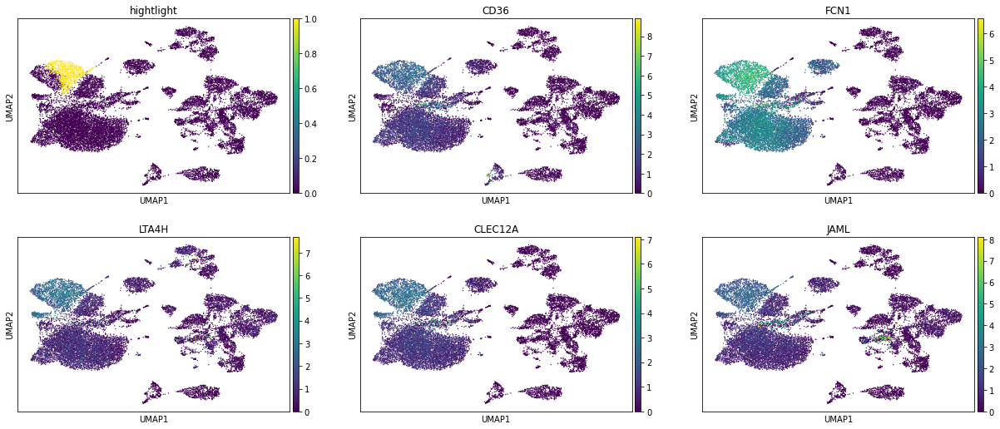

3


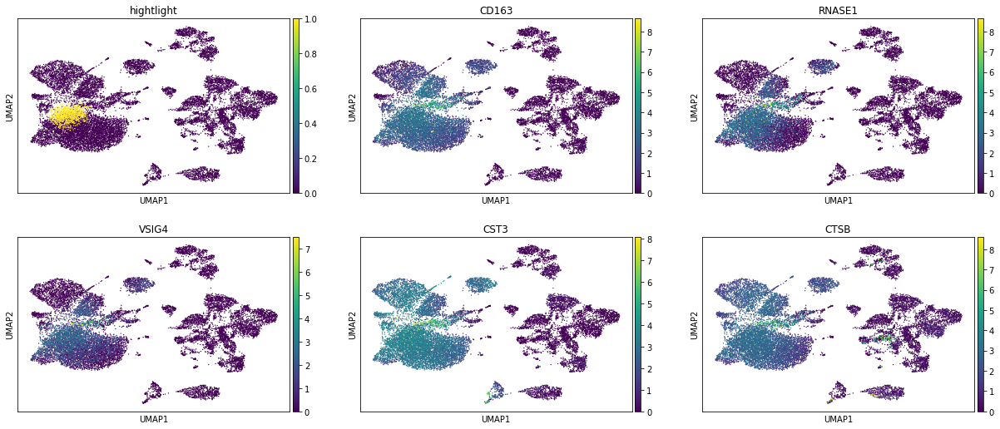

4


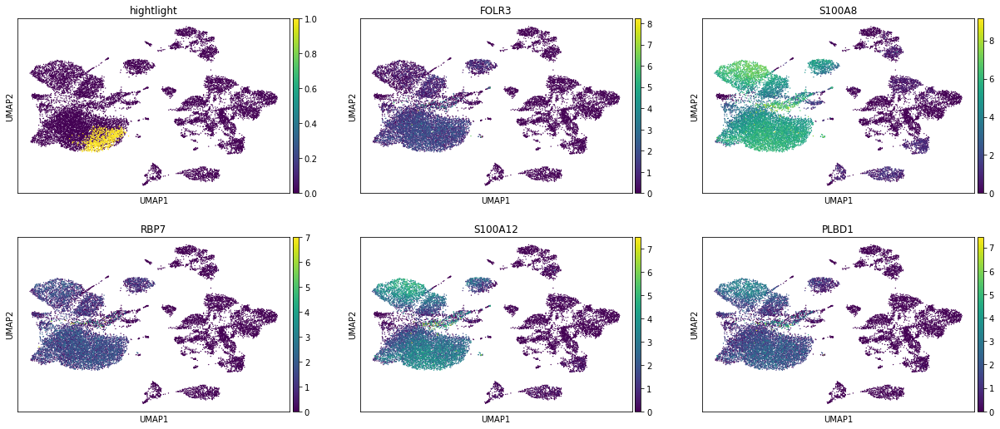

5


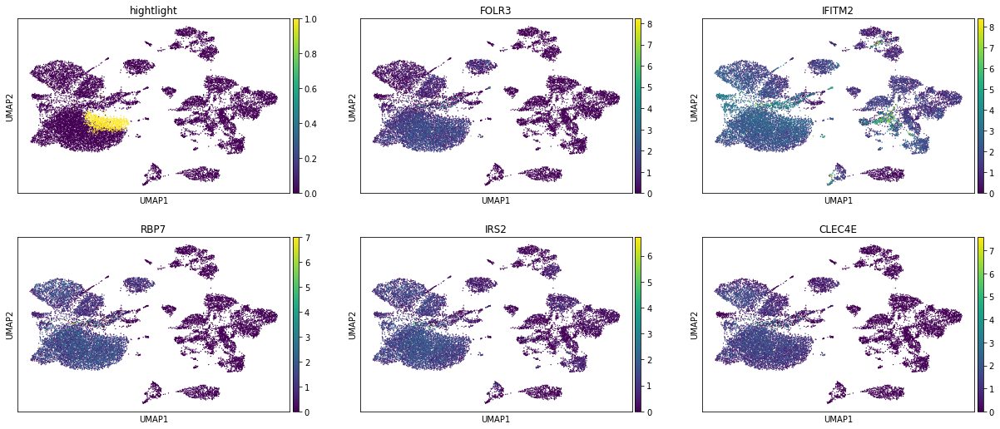

6


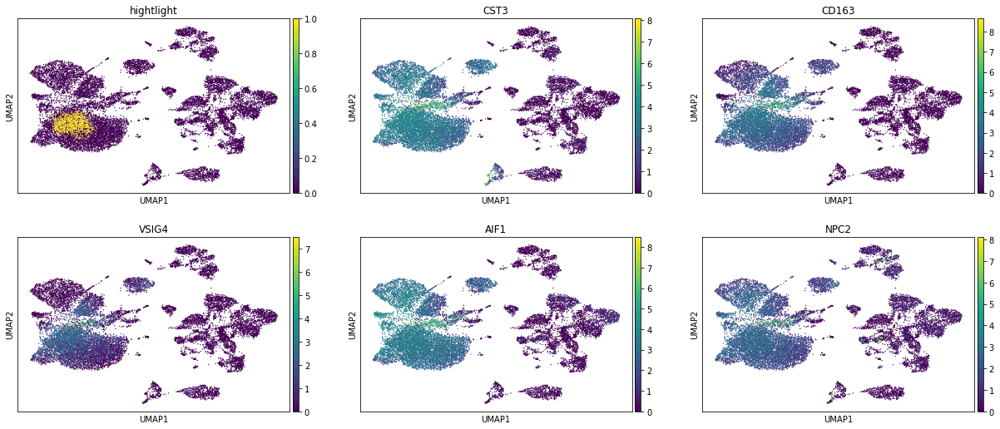

7


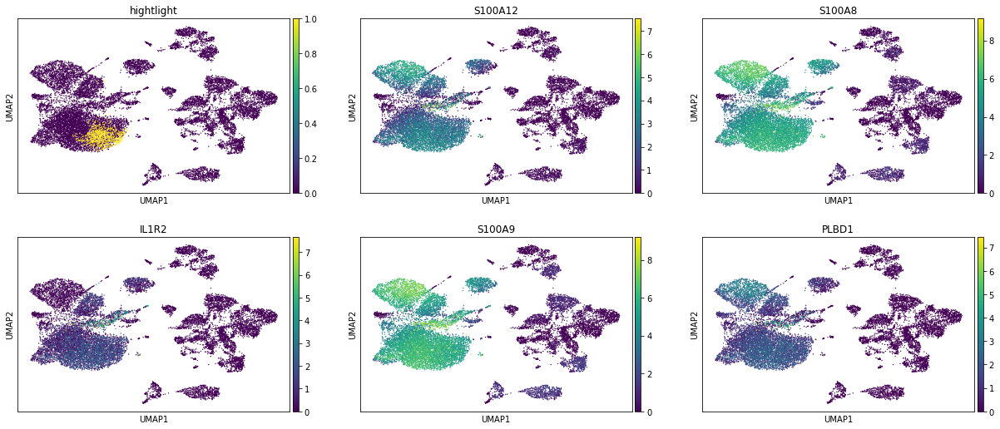

8


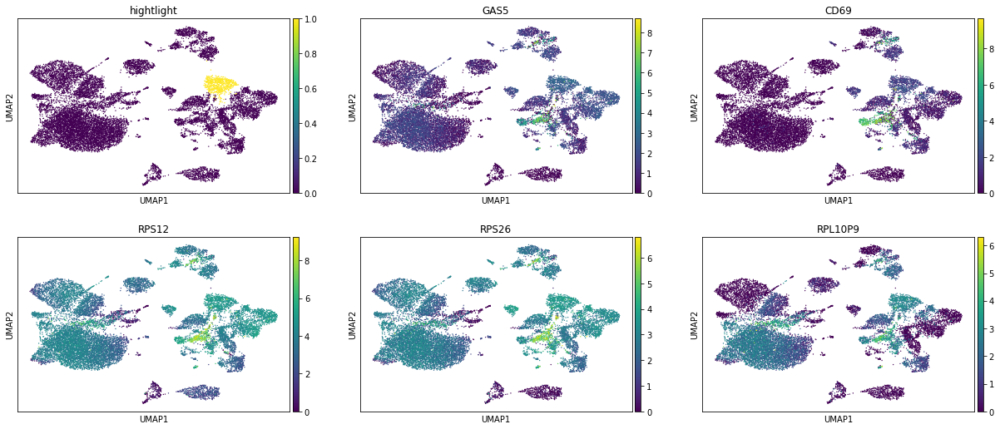

9


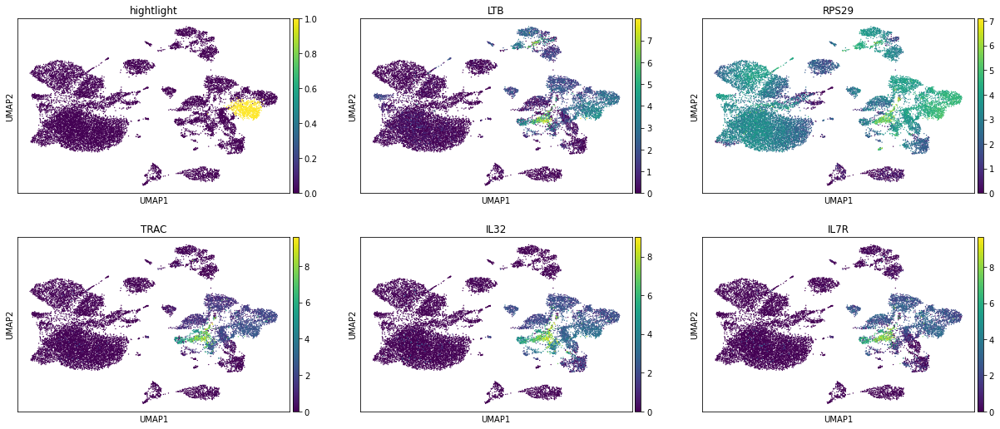

10


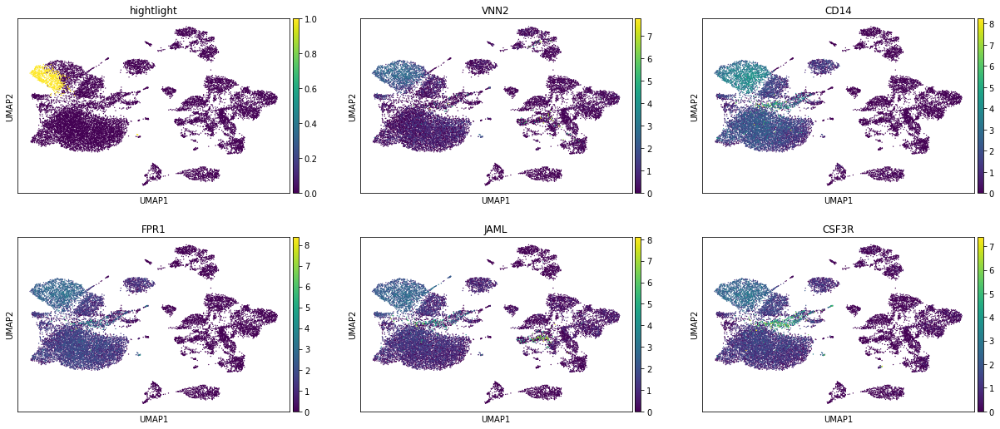

11


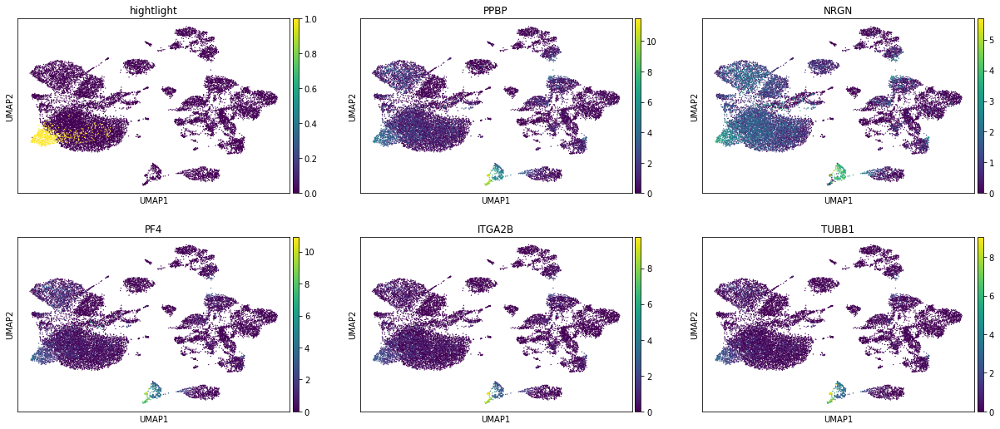

12


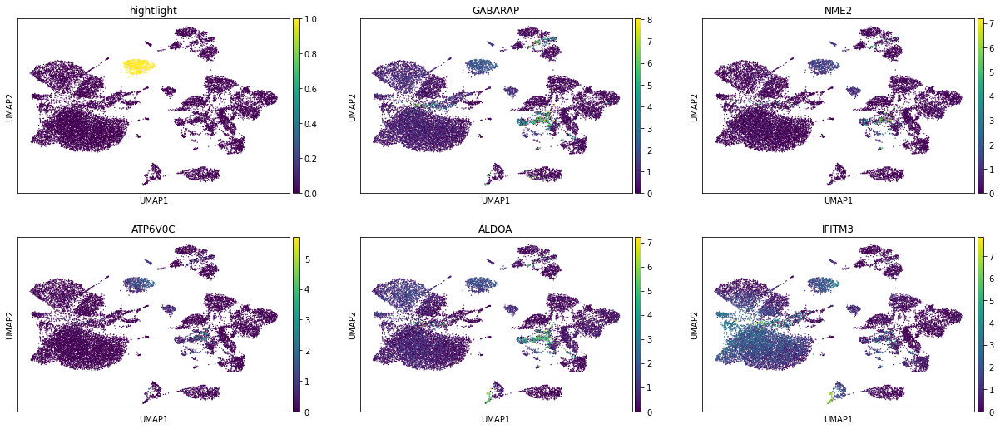

13


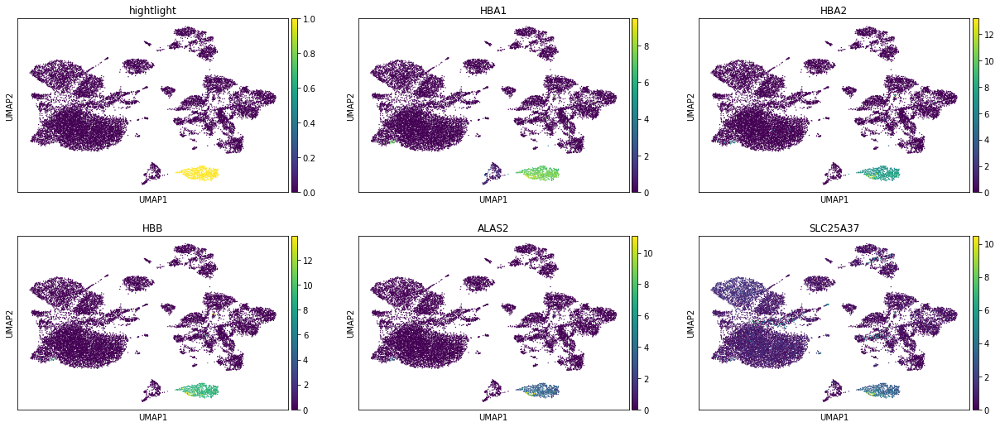

14


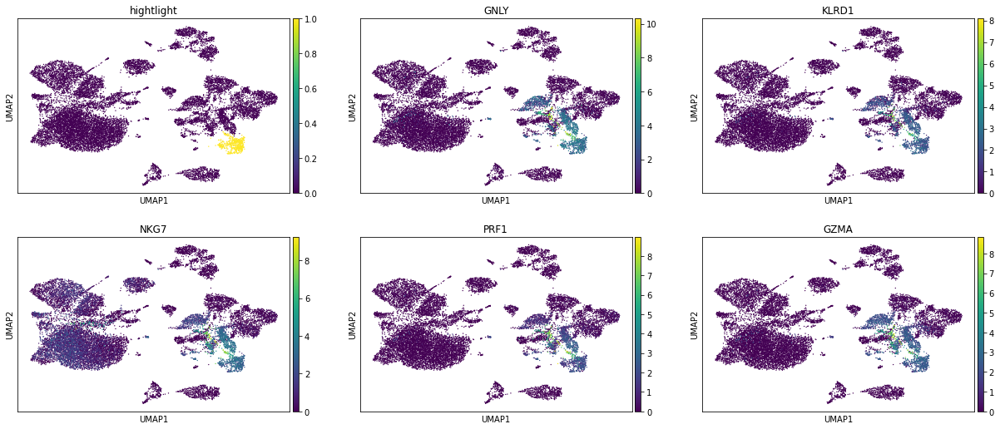

15


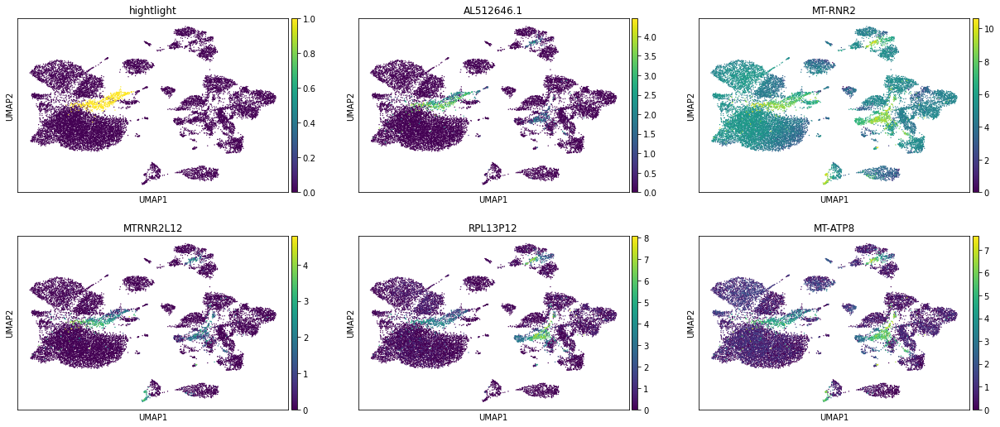

16


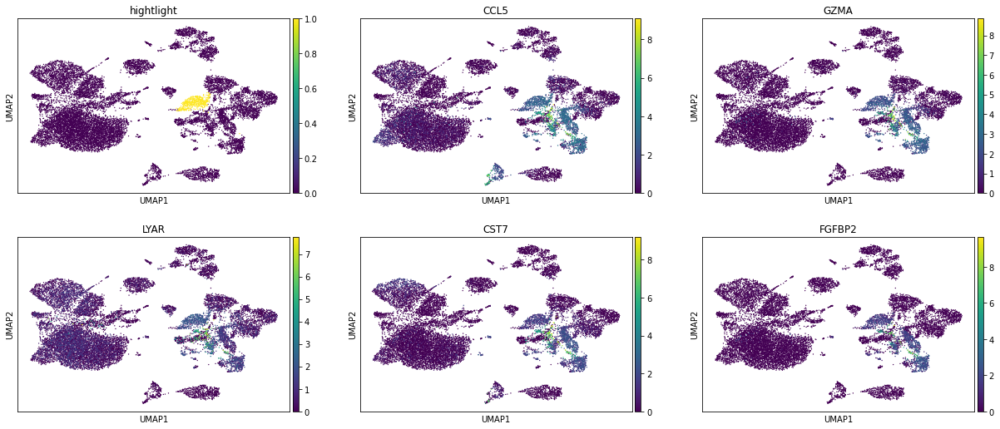

17


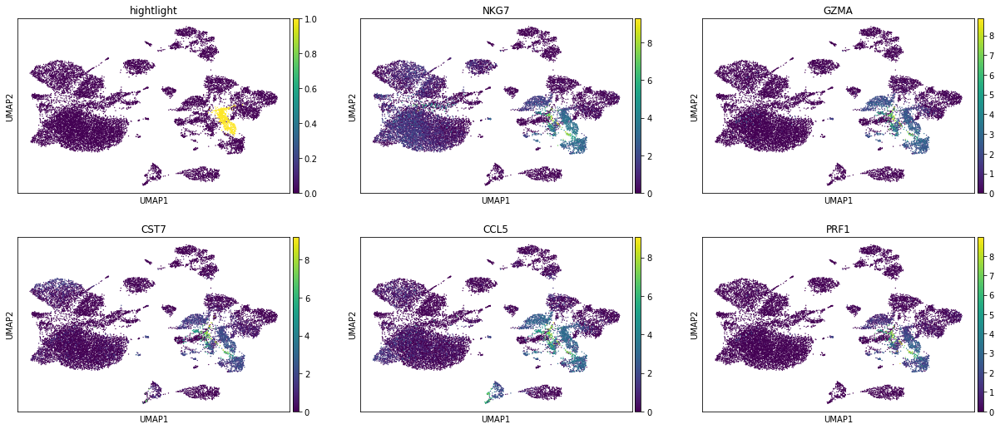

18


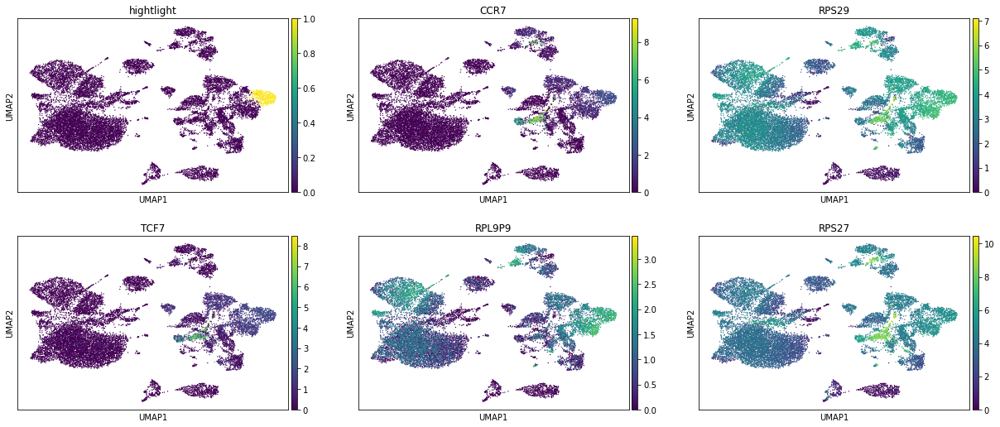

19


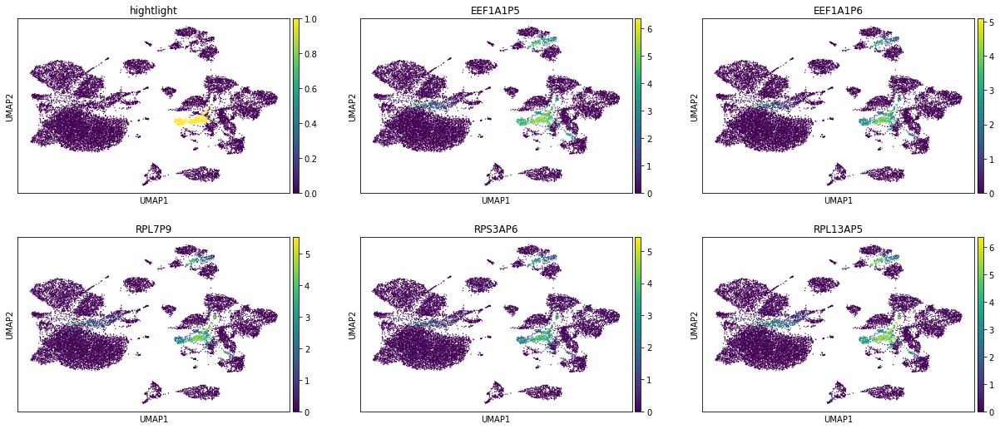

20


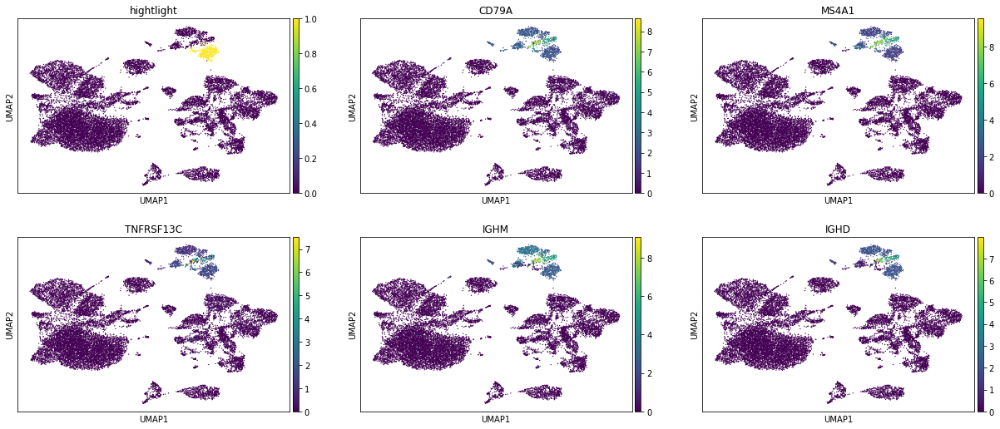

21


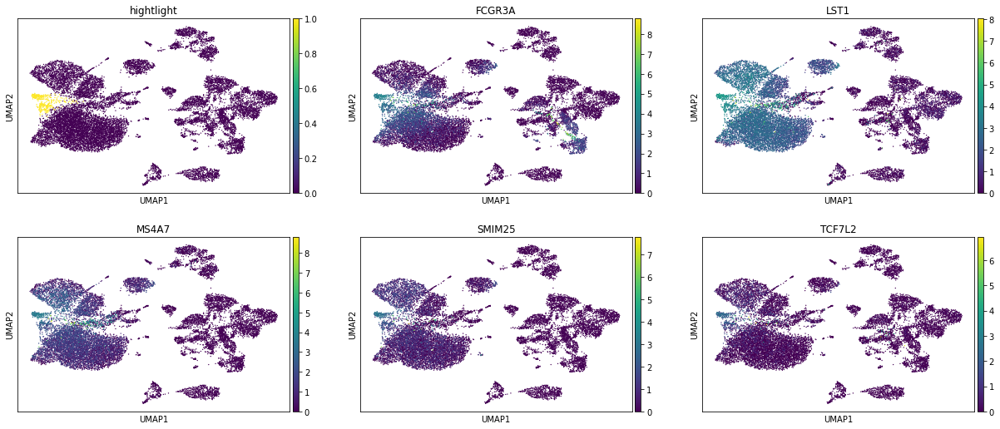

22


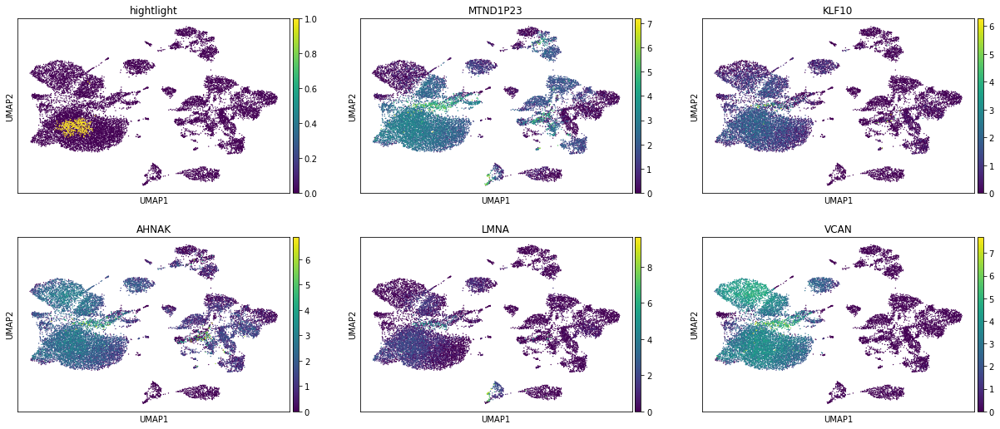

23


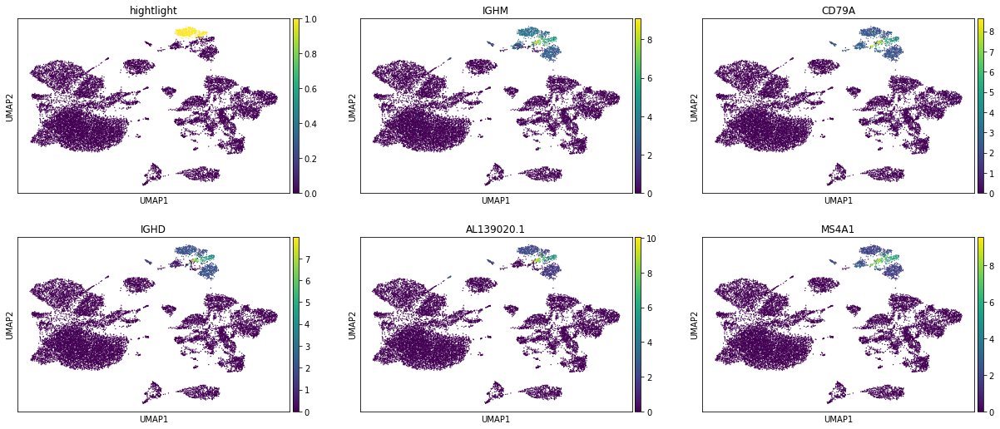

24


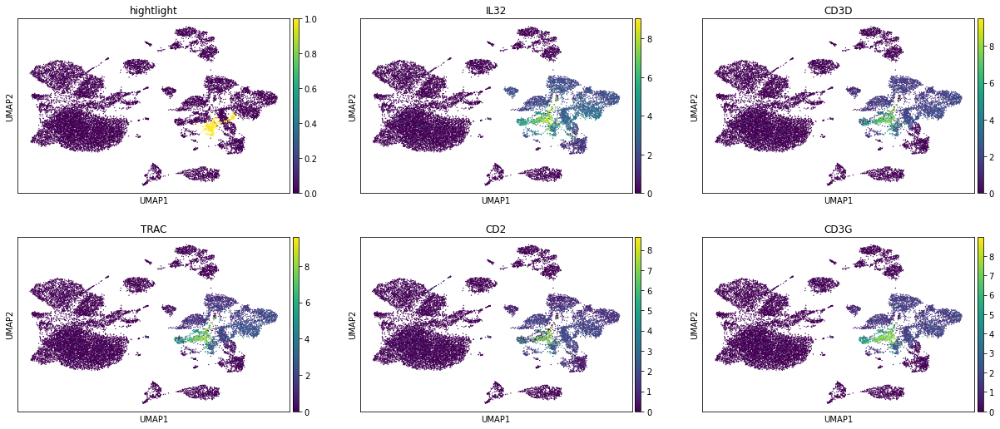

25


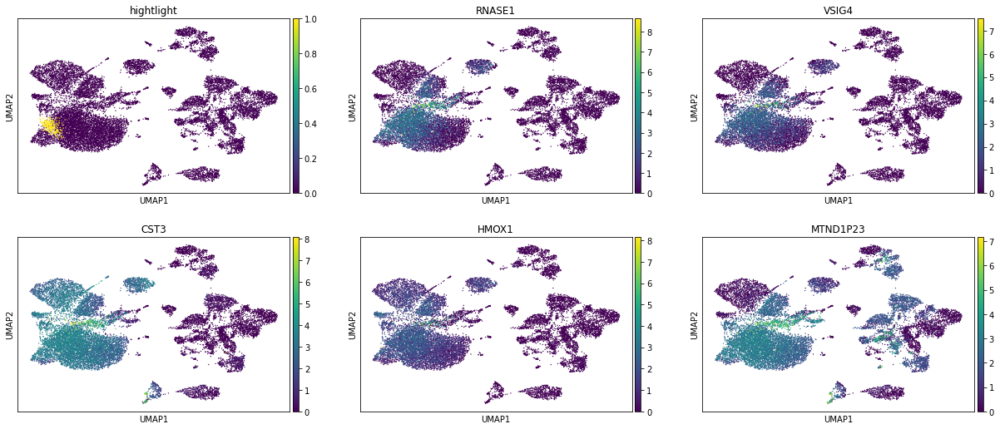

26


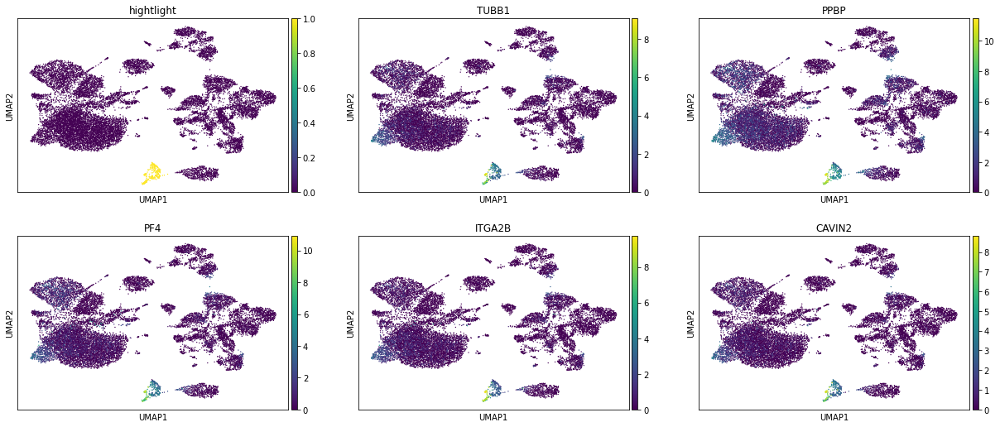

27


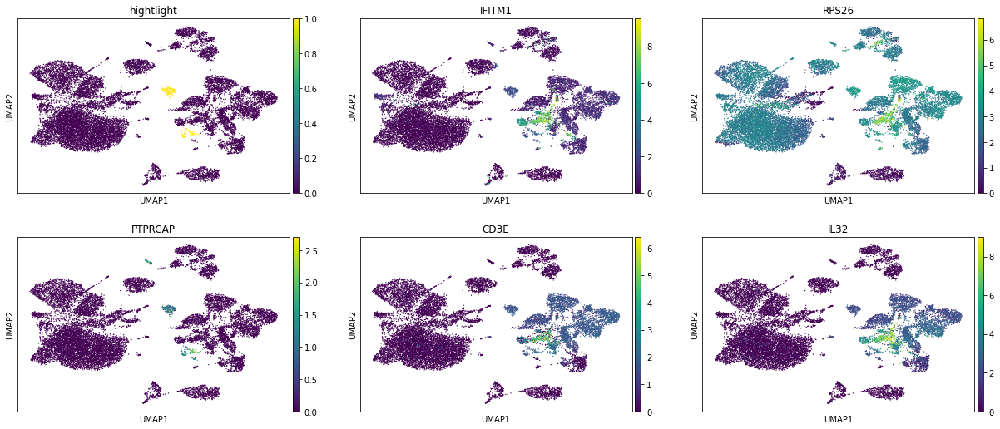

28


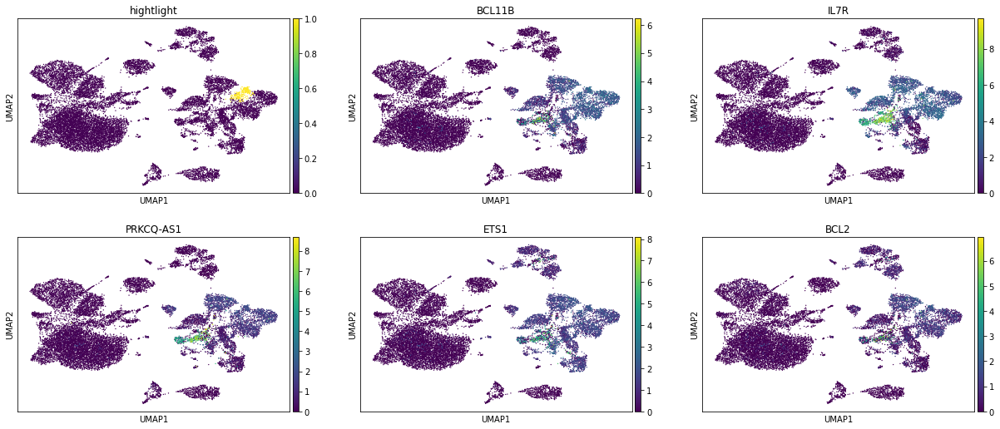

29


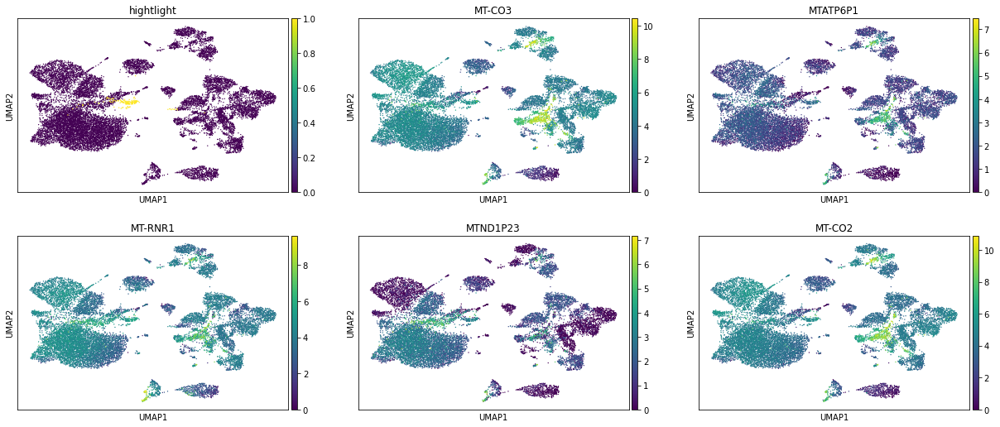

30


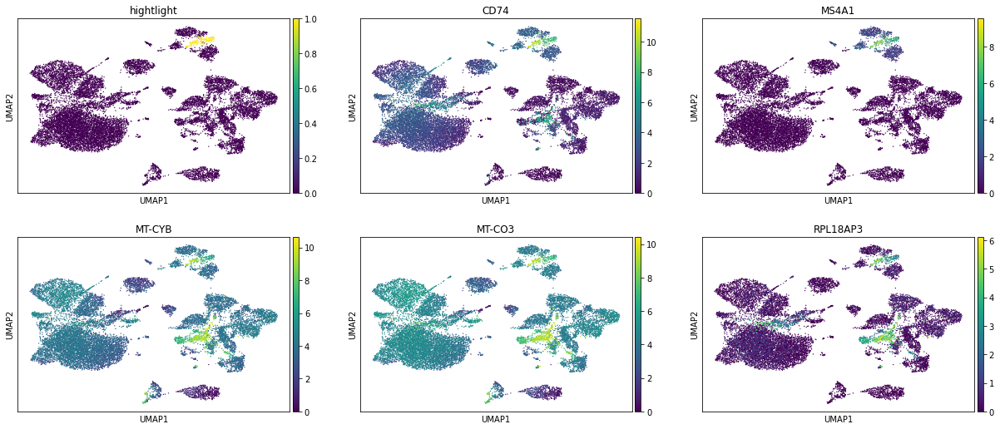

31


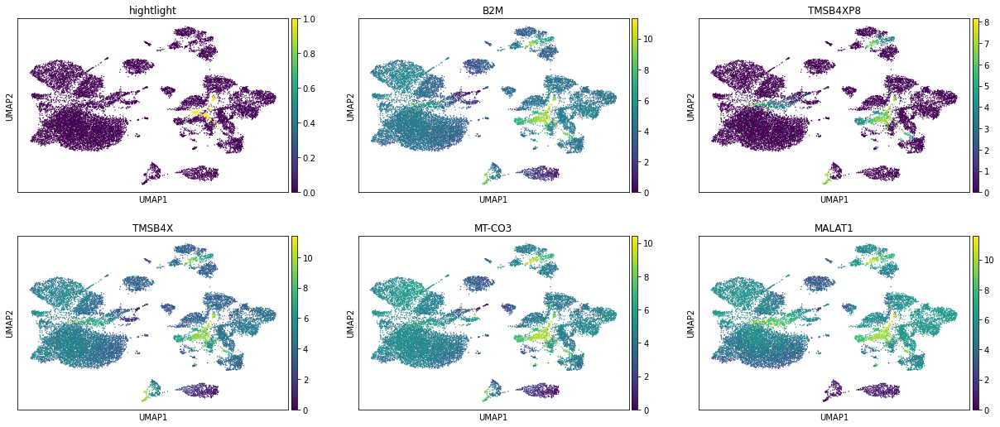

32


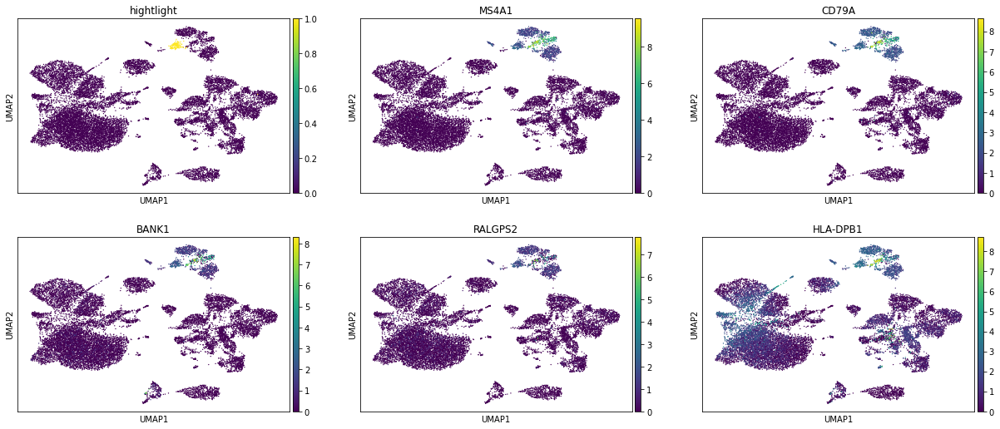

33


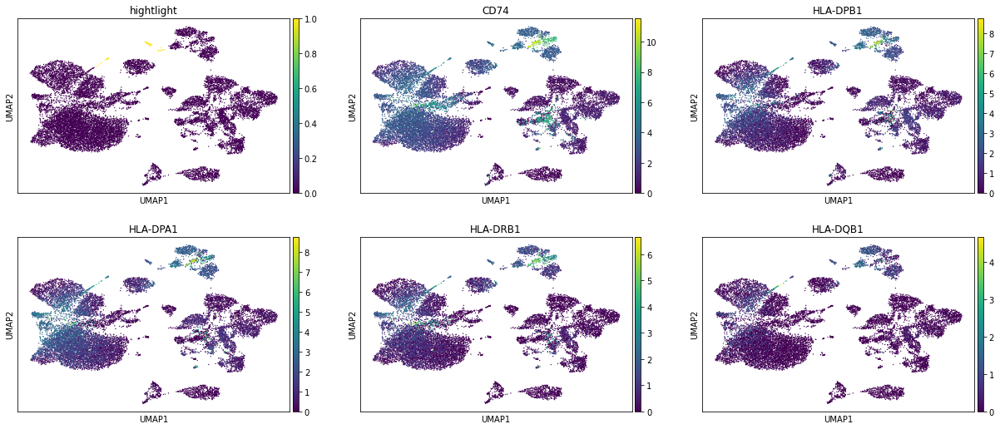

34


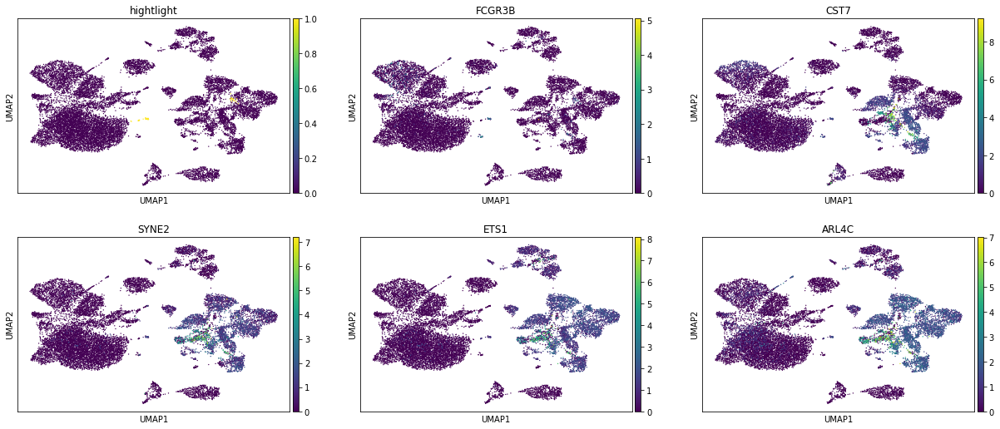

35


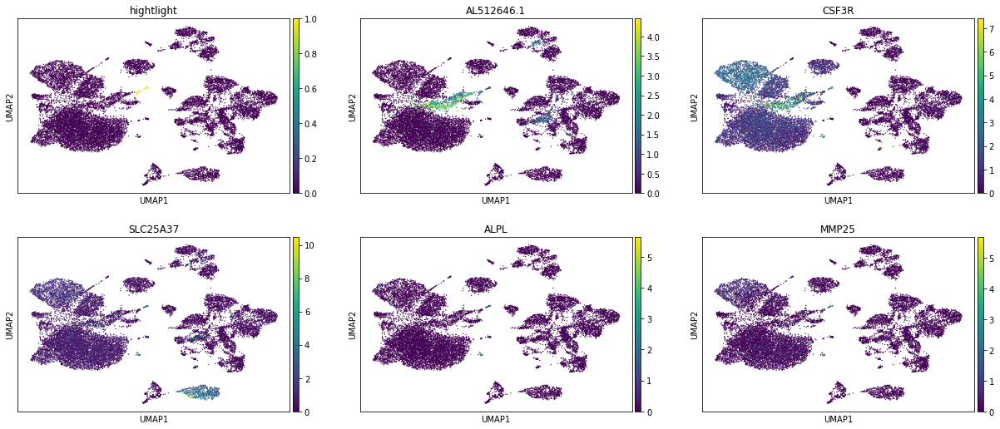

36


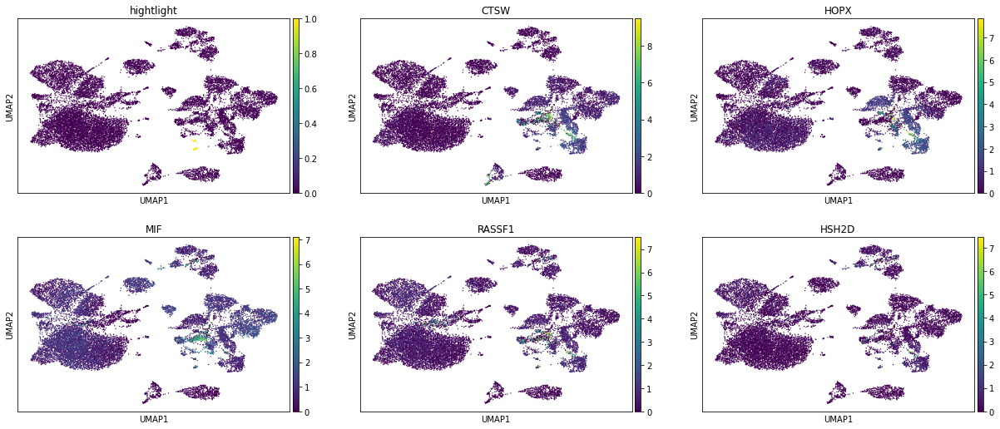

37


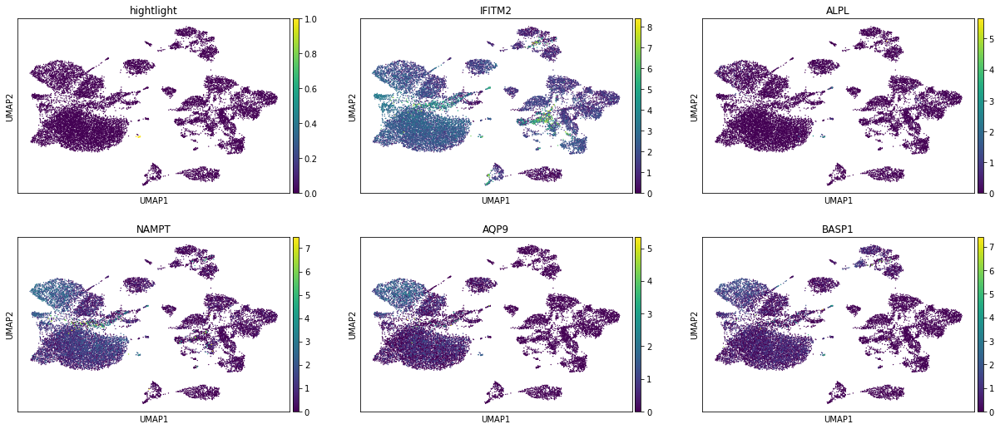

In [25]:
for x in DE.keys():
    print(x)
    topgenes = list(DE[x].T[:5].index)
    organ_adata.obs["hightlight"] = organ_adata.obs["leiden"] == x
    sc.pl.umap(
        organ_adata,
        color=["hightlight"] + topgenes,
        ncols=3,
    )

### The extended DE list can be queried by 

In [26]:
DE["0"].T

,wilcoxon_score,log fold change,adjusted pvalue
S100A9,38.174721,4.371098,0.000000e+00
LGALS1,38.112762,2.673520,0.000000e+00
LYZ,36.793514,3.587410,4.600361e-292
CAPG,36.637524,2.249778,1.064190e-289
S100A10,36.517776,2.094100,6.819694e-288
...,...,...,...
CD52,-13.961885,-1.725062,1.604588e-42
EVL,-14.118567,-2.770389,1.789802e-43
ARL4C,-14.163890,-3.148407,9.477935e-44
ETS1,-14.572637,-4.376012,2.758581e-46


# read in cell ontology 

In [27]:
import obonet

ont_dir = "/data/yosef2/users/chenling/TabulaSapiensData/ontology/"
obo = ont_dir + "cl.obo.txt"
f = open(obo, "r")
co = obonet.read_obo(f)
f.close()

celltype_dict = {}
for x in co.nodes:
    celltype_dict[co.nodes[x]['name']] = x



You can look up all T cell by typing celltype_dict['T'] and using tab complete  

In [28]:
celltype_dict['T cell']

'CL:0000084'

You can also look at the names of all subsets of T cell that contains 'CD4' in their names

In [29]:
import networkx as nx


def PrintChildren(co, parent, pattern=""):
    all_children = [x for x in nx.ancestors(co, celltype_dict[parent])]
    return [co.nodes[x]["name"] for x in all_children if pattern in co.nodes[x]["name"]]


PrintChildren(co, "T cell", "CD4")

['CD4-positive, CD25-positive, CCR4-positive, alpha-beta regulatory T cell',
 'CD4-positive type I NK T cell secreting interleukin-4',
 'CD4-positive, alpha-beta cytotoxic T cell',
 'central memory CD4-positive, alpha-beta T cell',
 'CD4-positive, alpha-beta intraepithelial T cell',
 'activated CD4-positive, alpha-beta T cell, human',
 'CD4-positive, alpha-beta thymocyte',
 'CD4-negative, CD8-negative type I NK T cell',
 'CD4-positive, CD25-positive, alpha-beta regulatory T cell',
 'CD4-negative, CD8-negative type I NK T cell secreting interleukin-4',
 'CD4-positive helper T cell',
 'CD4-positive, CXCR3-negative, CCR6-negative, alpha-beta T cell',
 'CD2-positive, CD5-positive, CD44-positive alpha-beta intraepithelial T cell',
 'CD4-negative, CD8-negative, alpha-beta intraepithelial T cell',
 'CD4-negative CD8-negative gamma-delta intraepithelial T cell',
 'activated CD4-positive type I NK T cell',
 'CD4-positive, CD8-intermediate double-positive thymocyte',
 'CD4-negative, CD8-negative

# manually create mapping between cluster and cell type (this is just an example), and the relevant marker genes that was used to generate this prediction

In [30]:
organ_adata.obs["annotation_oct2020"] = organ_adata.obs["leiden"].copy()
cluster_mapping = {"0": "T cell"}
cluster_markers = {"0": ["CXCR4", "CD3D", "IL7R", "IL32"]}

This cell will automatically replace the leiden cluster names with cell type annotations

In [31]:
for l in cluster_mapping.keys():
    organ_adata.obs["annotation_oct2020"].replace(l, cluster_mapping[l], inplace=True)
    display(DE[l][cluster_markers[l]])

,CXCR4,CD3D,IL7R,IL32
wilcoxon_score,-8.673412e+00,-1.187982e+01,-1.226517e+01,-1.388934e+01
log fold change,-1.215294e+00,-4.636583e+00,-5.424578e+00,-4.832691e+00
adjusted pvalue,1.291202e-16,7.034815e-31,6.823818e-33,4.379898e-42


# Visualize the results of the manual annotation

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



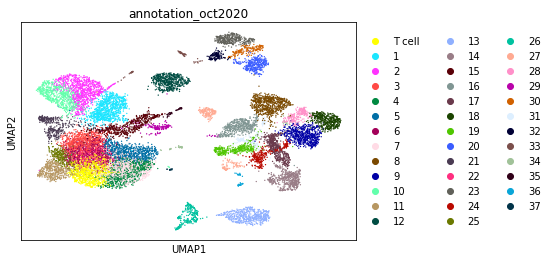

In [32]:
sc.pl.umap(
    organ_adata,
    color=["annotation_oct2020"],
    ncols=3,
)

# manually create mapping between cell type and compartment (this is just an example)

In [33]:
organ_adata.obs["compartment_oct2020"] = organ_adata.obs["annotation_oct2020"].copy()
compartment_mapping = {"T cell": "Immune"}

This cell will automatically replace the leiden cluster names with cell type annotations

In [34]:
for c in compartment_mapping.keys():
    organ_adata.obs["compartment_oct2020"].replace(
        c, compartment_mapping[c], inplace=True
    )

# Visualize the results of the new compartment splitting

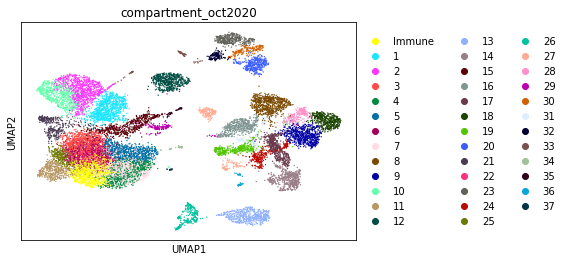

In [35]:
sc.pl.umap(
    organ_adata,
    color=["compartment_oct2020"],
    ncols=3,
)

# save data

In [36]:
organ_adata.write_h5ad(
    data_path + "decontX/organ_data/Pilot1_Pilot2.decontX.%s.h5ad" % organ
)